## Install Libraries

In [ ]:
!pip install powerlaw

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.0/192.0 kB 4.8 MB/s eta 0:00:00


In [ ]:
!pip install py3Dmol

In [ ]:
!pip install Infomap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 264.8/264.8 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for Infomap: filename=infomap-2.8.0-cp312-cp312-linux_x86_64.whl size=7716619 sha256=fe4dd857eade05d909192ee8ef6bb296840b1f434be3075c2611fa5f9b4c2b52
  Stored in directory: /root/.cache/pip/wheels/0a/d5/d5/dab47e5b039fb1997c5ca2835ee7c9a7c7e1bf2615191aebb1
Successfully built Infomap


In [ ]:
!pip install Bio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 321.3/321.3 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 kB 2.3 MB/s eta 0:00:00


In [ ]:
!pip install biopython propka

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.1/104.1 kB 2.1 MB/s eta 0:00:00


## Local libraries

In [ ]:
import sys
sys.path.append('../modules')

from network_generation import *
from network_analisis import *
from structural_analisis import *

## Configuration

In [ ]:
import json
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
from collections import Counter
import seaborn as sns

In [ ]:
# Configuración de estilo para las visualizaciones
plt.style.use('seaborn-v0_8-darkgrid')
matplotlib.rcParams['figure.figsize'] = [12, 8]
matplotlib.rcParams['font.size'] = 12

# Application

## ICL2 Apo form analysis [(6EDW)](https://www.rcsb.org/structure/6EDW)

 #### a) Uploading and network generation

In [ ]:
# Upload data GPCR-Drug complex
json_path = "../graphs/6EDW-R-Network.json"
data01 = load_ring_json_data(json_path)

File loaded successfully
Main keys: ['data', 'directed', 'multigraph', 'elements']
Directed graph: False
Multigraph: True


In [ ]:
# Extract nodes and edges
nodes_S01, edges_S01 = extract_nodes_edges(data01)
# Create DataFrames
df_nodes_S01 = pd.DataFrame(nodes_S01)
df_edges_S01 = pd.DataFrame(edges_S01)

Number of nodes extracted: 2961
Number of edges (interactions) extracted: 5396


In [ ]:
df_nodes_S01

,id,name,residue,chain,resi,resn,degree,dssp,x_coord,y_coord,z_coord
0,A/100/ILE,A/100/ILE,A/100/ILE,A,100,ILE,2,,0.169,0.422,0.534
1,A/101/GLU,A/101/GLU,A/101/GLU,A,101,GLU,3,,0.175,0.455,0.544
2,A/102/ALA,A/102/ALA,A/102/ALA,A,102,ALA,2,,0.217,0.452,0.549
3,A/103/ILE,A/103/ILE,A/103/ILE,A,103,ILE,3,E,0.253,0.434,0.545
4,A/104/TYR,A/104/TYR,A/104/TYR,A,104,TYR,7,E,0.283,0.416,0.556
...,...,...,...,...,...,...,...,...,...,...,...
2956,D/95/MET,D/95/MET,D/95/MET,D,95,MET,6,H,0.806,0.550,0.502
2957,D/96/LYS,D/96/LYS,D/96/LYS,D,96,LYS,6,H,0.820,0.521,0.490
2958,D/97/ARG,D/97/ARG,D/97/ARG,D,97,ARG,2,H,0.837,0.543,0.476
2959,D/98/MET,D/98/MET,D/98/MET,D,98,MET,3,H,0.859,0.561,0.491


In [ ]:
df_edges_S01

,source,target,interaction,type,distance,probability,energy
0,A/100/ILE,A/83/THR,VDW,,2.698,1.0,0
1,A/100/ILE,A/95/MET,HBOND,,3.101,1.0,0
2,A/101/GLU,A/70/ARG,HBOND,,2.697,1.0,0
3,A/101/GLU,A/70/ARG,HBOND,,2.792,1.0,0
4,A/101/GLU,A/70/ARG,IONIC,,3.562,1.0,0
...,...,...,...,...,...,...,...
5391,D/93/VAL,D/97/ARG,HBOND,,3.027,1.0,0
5392,D/93/VAL,D/97/ARG,VDW,,3.265,1.0,0
5393,D/94/SER,D/98/MET,HBOND,,2.924,1.0,0
5394,D/95/MET,D/98/MET,VDW,,2.894,1.0,0


In [ ]:
# Save DataFrames
df_nodes_S01.to_csv('protein_nodes.csv', index=False)
df_edges_S01.to_csv('protein_interactions.csv', index=False)

In [ ]:
# Create Network
G_S01 = create_graph_from_dataframes(df_nodes_S01, df_edges_S01)

**Basic descriptors**

In [ ]:
print("\n=== GRAPH INFORMATION ===")
print(f"Number of nodes: {G_S01.number_of_nodes()}")
print(f"Number of edges: {G_S01.number_of_edges()}")
print(f"Graph density: {nx.density(G_S01):.4f}")
print(f"Is the graph connected? {nx.is_connected(G_S01)}")

# Additional information about nodes
if G_S01.number_of_nodes() > 0:
    first_node = list(G_S01.nodes(data=True))[0]
    print(f"\nNode example: {first_node[0]}")
    print(f"Node attributes: {first_node[1]}")


=== GRAPH INFORMATION ===
Number of nodes: 2961
Number of edges: 3864
Graph density: 0.0009
Is the graph connected? False

Node example: A/100/ILE
Node attributes: {'residue': 'A/100/ILE', 'chain': 'A', 'resi': 100, 'resn': 'ILE', 'degree': 2, 'dssp': ' ', 'x_coord': 0.169, 'y_coord': 0.422, 'z_coord': 0.534}


### Analisis 1

#### **a) Clustering: average clustering coefficient.**

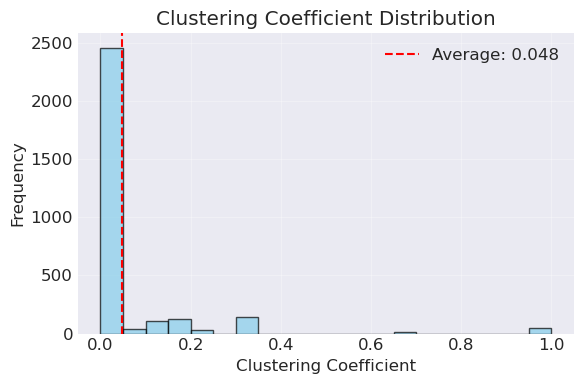

Average Clustering Coefficient: 0.0480
Number of nodes: 2961
Number of edges: 3864


In [ ]:
df_Clustering_coefficient_G_S01=analyze_clustering(G_S01)

#### **b) Distances: average shortest–path length and (effective) diameter.**

Graph not connected. Using giant component...
Nodes in giant component: 2727
Calculating distances... (may take time for large graphs)


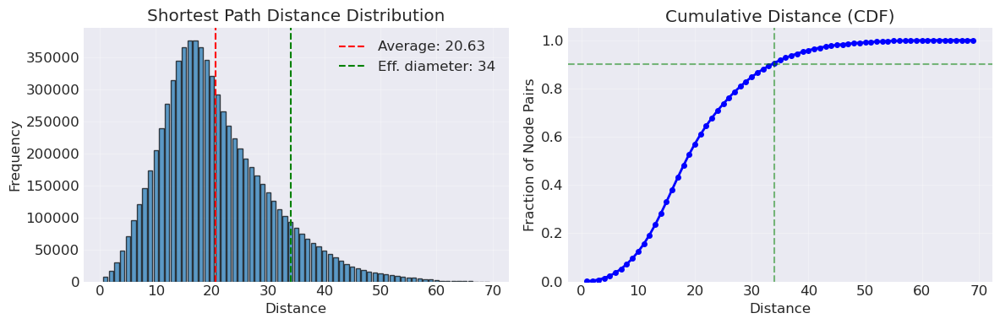


=== DISTANCE RESULTS ===
Average path length: 20.6344
Diameter (maximum distance): 69
Effective diameter (90%): 34
Number of node pairs: 7433802
Most common distance: 16 (appears 376822 times)


In [ ]:
dict_Distances_G_S01=analyze_distances(G_S01)

#### **c) Degree statistics:**

**Degree distribution**

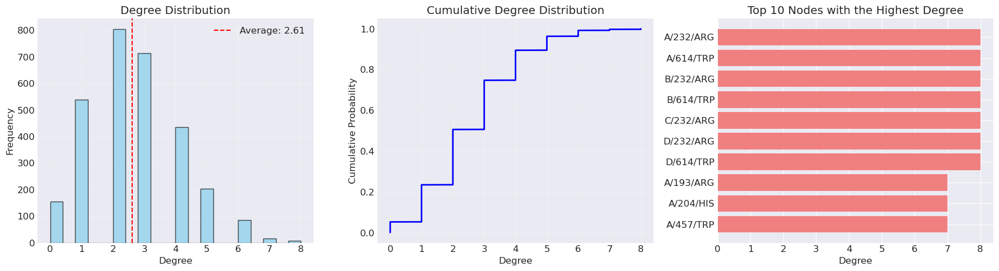


=== DEGREE STATISTICS===
Average degree: 2.61
Highest degree: 8
Minimum degree: 0
Standard deviation: 1.46

Top 10 residues with a higher average grade:
  TRP: 5.75
  TYR: 3.86
  PHE: 3.67
  HIS: 3.29
  ARG: 3.29
  CSX: 3.25
  ASN: 3.07
  MET: 3.00
  MG: 3.00
  ILE: 2.78


In [ ]:
# Generar gráficos de distribución de grado
degrees_S01 = plot_distribucion_grado(G_S01)

**Degree statistics: Network topology analysis**

/home/christian/.local/share/mamba/envs/r_env/lib/python3.14/site-packages/powerlaw/fitting.py:264: UserWarning:

Values less than or equal to 0 in data. Throwing out 0 or negative values.



Calculating best minimal value for power law fit


Fitting xmin: 100%|██████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 388.18it/s]
/home/christian/.local/share/mamba/envs/r_env/lib/python3.14/site-packages/powerlaw/distributions.py:743: OptimizeWarning:

Initial guess is not within the specified bounds



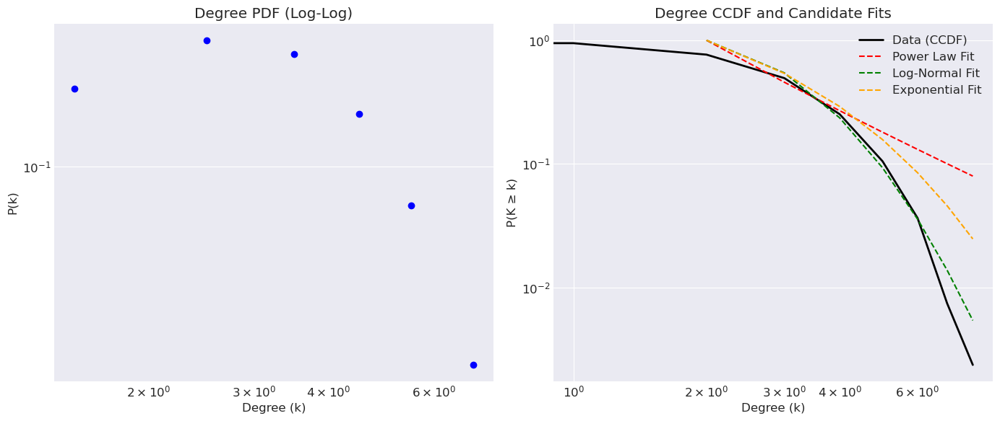

Estimated Alpha value (Power Law): 2.61
xmin value (tail start): 2.0

Power Law vs Exponential comparison: R=-342.53, p-value=0.0000
Power Law vs Log-Normal comparison: R=-458.48, p-value=0.0000


In [ ]:
analyze_degree_statistics(G_S01)

**Discussion**

- **$α=2.61$:** This value falls within the typical range for "small-world" networks (usually between 2<α<3) but the likelihood ratio tests indicate otherwise. Then, this number is only an estimate of the slope in a specific segment, but does not define the overall nature of the network.
- **Negative R (R<0):** In both the comparison with the Exponential (R=−342.53) and Log-Normal (R=−458.48) models, the negative sign indicates that the second model is much better than Power Law at explaining the data.
- **Statistical Significance (p=0.0000):** Because it is less than 0.05, with complete certainty these results are not due to chance.

After performing a goodness-of-fit analysis using the Likelihood Ratio Test, the hypothesis of a Power Law distribution was rejected (p<0.05). The data show a statistically significant preference for a Log-Normal distribution (R=−458.48), suggesting that the network does not have a scale-free architecture, but rather exhibits saturation in the connectivity of the most important nodes. In terms of protein physics, the coexistence of a Log-Normal degree distribution with Small-world properties reveals how evolution has optimized the protein structure to be efficient:
- **Log-Normal distribution**:  The fact that the likelihood ratio (R) test favors the Log-Normal distribution over the Power Law distribution is due to spatial and volume exclusion constraints (Steric Saturation). In a social network, a "hub" can have infinite connections but in a protein, a residue has a limited physical space around it. Fifty residues cannot fit in direct contact with a single residue. This creates a "saturation point" that cuts off the tail of the distribution (typical of a Log-Normal distribution).
- **Small-world propertie**: The value of α=2.61 is in the range typically associated with scale-free networks (2-3), but even if the network is not purely scale-free (as the R value proved), this exponent reflects a Small-World topology:
    * **Structural Shortcuts (Long-range contacts):** Protein folding brings together residues that are far apart in the primary sequence (in the linear chain). These long-range contacts act as "bridges" or shortcuts.
    * **High Connectivity of Critical Nodes:** Although there are not "super-hubs" of 500 edges, there are residues with above-average connectivity (residues in the hydrophobic core). A value of α of 2.61 indicates that there are enough nodes with moderately high connectivity to keep the entire protein connected with very few steps (an average of 3 to 5 jumps between any pair of residues). The protein needs to transmit allosteric signals (information) rapidly from one end to the other for its catalytic or binding function. Therefore, it maintains a low α value, which ensures that the shortest path between residues is short.



#### **d) Centrality structure:**

**Centrality_distribution**


=== CENTRALITY ANALYSIS ===
Calculating betweenness centrality...
Calculating closeness centrality...
Calculating degree centrality...
Calculating eigenvector centrality...


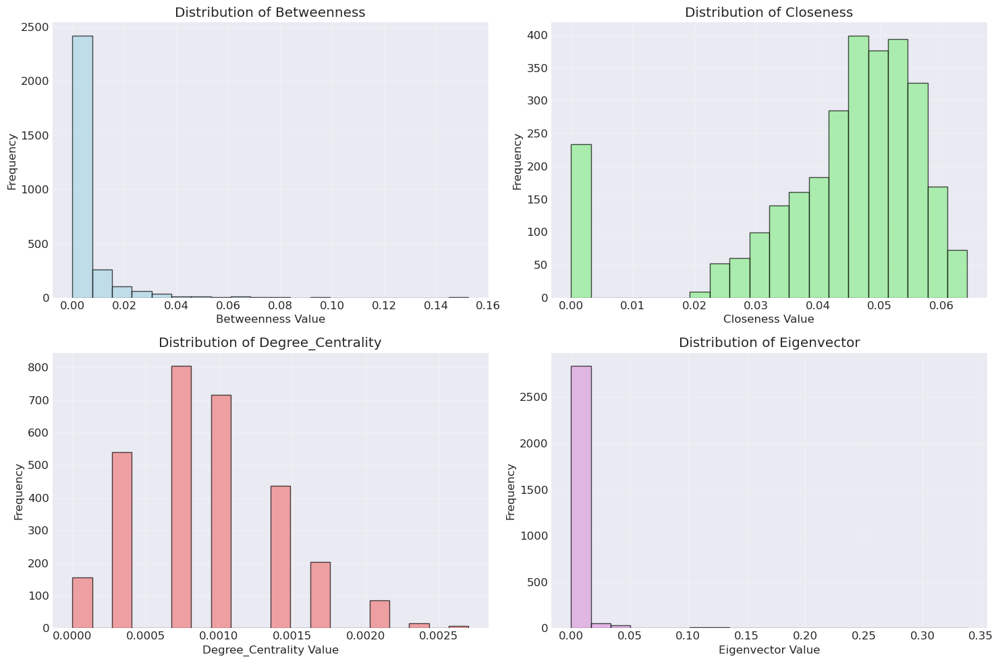


=== TOP NODES BY CENTRALITY ===

Top 5 by Betweenness:
     Node   Residue  Betweenness
D/385/GLU D/385/GLU     0.152552
D/272/PHE D/272/PHE     0.147662
D/373/GLU D/373/GLU     0.147328
D/436/ARG D/436/ARG     0.147061
D/381/PHE D/381/PHE     0.142937

Top 5 by Closeness:
     Node   Residue  Closeness
A/193/ARG A/193/ARG   0.064156
B/195/PHE B/195/PHE   0.063840
C/193/ARG C/193/ARG   0.063736
B/141/ARG B/141/ARG   0.063730
D/118/GLU D/118/GLU   0.063650

Top 5 by Degree_Centrality:
     Node   Residue  Degree_Centrality
A/232/ARG A/232/ARG           0.002703
A/614/TRP A/614/TRP           0.002703
B/232/ARG B/232/ARG           0.002703
B/614/TRP B/614/TRP           0.002703
C/232/ARG C/232/ARG           0.002703

Top 5 by Eigenvector:
     Node   Residue  Eigenvector
A/494/TRP A/494/TRP     0.338279
C/552/GLN C/552/GLN     0.298921
A/507/PHE A/507/PHE     0.270282
C/545/MET C/545/MET     0.268993
C/548/LEU C/548/LEU     0.218127


In [ ]:
# Realizar análisis de centralidad
centralidad_df_S01 = analyze_centrality(G_S01)

**Centrality structure: Rank the top 50 nodes**

In [ ]:
df_full_G_S01, df_top50_G_S01 = analyze_centrality_rankings(G_S01)

Calculating centrality metrics... this may take a moment.
Top 50 saved to 'top_50_centralities.csv'


In [ ]:
# Guardar DataFrame como CSV
df_full_G_S01.to_csv('G_S01_full_centrality.csv', index=False)

In [ ]:
# Open CSV as DataFrame
df_full_G_S01 = pd.read_csv('G_S01_full_centrality.csv')

In [ ]:
df_full_G_S01

,Degree_Val,Degree_Rank,Closeness_Val,Closeness_Rank,Betweenness_Val,Betweenness_Rank,Eigenvector_Val,Eigenvector_Rank,Katz_Val,Katz_Rank,PageRank_Val,PageRank_Rank,Subgraph_Val,Subgraph_Rank
A/100/ILE,0.000676,1463.0,0.052944,752.0,0.001898,1252.0,0.042878,56.0,0.017434,1519.0,0.000225,2324.0,2.637792,1590.0
A/101/GLU,0.000338,2267.0,0.048940,1246.0,0.000000,2223.0,0.004518,240.0,0.015190,2328.0,0.000160,2699.0,1.766558,2340.0
A/102/ALA,0.000676,1463.0,0.051274,965.0,0.000445,1935.0,0.044751,50.0,0.017200,1572.0,0.000233,2300.0,2.671229,1571.0
A/103/ILE,0.000676,1463.0,0.051847,896.0,0.000490,1911.0,0.004882,231.0,0.016480,2007.0,0.000266,2051.0,2.345275,2060.0
A/104/TYR,0.001689,109.0,0.057591,253.0,0.032399,105.0,0.119124,20.0,0.024254,135.0,0.000483,472.0,6.361801,212.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D/95/MET,0.001351,312.0,0.056502,350.0,0.004644,785.0,0.000464,650.0,0.021148,485.0,0.000439,673.0,4.678586,579.0
D/96/LYS,0.001351,312.0,0.049270,1206.0,0.001866,1260.0,0.000013,1484.0,0.019060,1009.0,0.000685,45.0,3.822180,907.0
D/97/ARG,0.000338,2267.0,0.050457,1065.0,0.000000,2223.0,0.000022,1364.0,0.014731,2580.0,0.000188,2456.0,1.644430,2580.0
D/98/MET,0.001014,748.0,0.053246,722.0,0.001308,1414.0,0.000177,886.0,0.018509,1226.0,0.000390,972.0,3.394096,1185.0


In [ ]:
df_full_G_S01F = df_full_G_S01.reset_index().rename(columns={'index': 'Node'})

In [ ]:
# Guardar DataFrame como CSV
df_top50_G_S01.to_csv('G_S01_top50_centrality.csv', index=False)

In [ ]:
# Open CSV as DataFrame
df_top50_G_S01 = pd.read_csv('G_S01_top50_centrality.csv')

In [ ]:
df_top50_G_S01

,Degree,Closeness,Betweenness,Eigenvector,Katz,PageRank,Subgraph
0,A/614/TRP,A/193/ARG,D/385/GLU,A/494/TRP,B/614/TRP,D/614/TRP,C/232/ARG
1,B/614/TRP,B/195/PHE,D/272/PHE,C/552/GLN,A/614/TRP,D/396/TRP,B/614/TRP
2,D/614/TRP,C/193/ARG,D/373/GLU,A/507/PHE,C/232/ARG,A/614/TRP,D/232/ARG
3,C/232/ARG,B/141/ARG,D/436/ARG,C/545/MET,D/614/TRP,B/614/TRP,A/232/ARG
4,A/232/ARG,D/118/GLU,D/381/PHE,C/548/LEU,D/232/ARG,B/96/LYS,A/494/TRP
5,D/232/ARG,B/198/VAL,D/377/ASP,A/486/TYR,A/232/ARG,B/232/ARG,B/232/ARG
6,B/232/ARG,D/127/TYR,D/269/ASP,A/504/MET,B/232/ARG,D/232/ARG,D/50/ARG
7,B/552/GLN,B/133/PRO,B/195/PHE,A/521/ILE,C/552/GLN,D/654/LEU,D/494/TRP
8,B/91/GLN,B/137/ALA,C/373/GLU,C/549/ALA,A/494/TRP,D/296/TYR,C/552/GLN
9,C/457/TRP,C/190/ASN,C/272/PHE,A/520/PHE,A/193/ARG,A/232/ARG,C/494/TRP


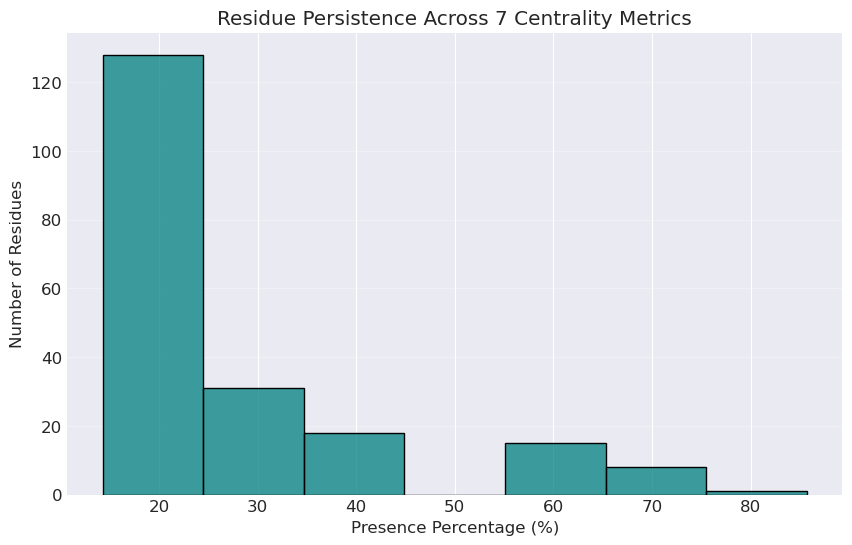

In [ ]:
df_persistencedf_top50_G_S01 = analyze_top_residues_consensus(df_top50_G_S01)

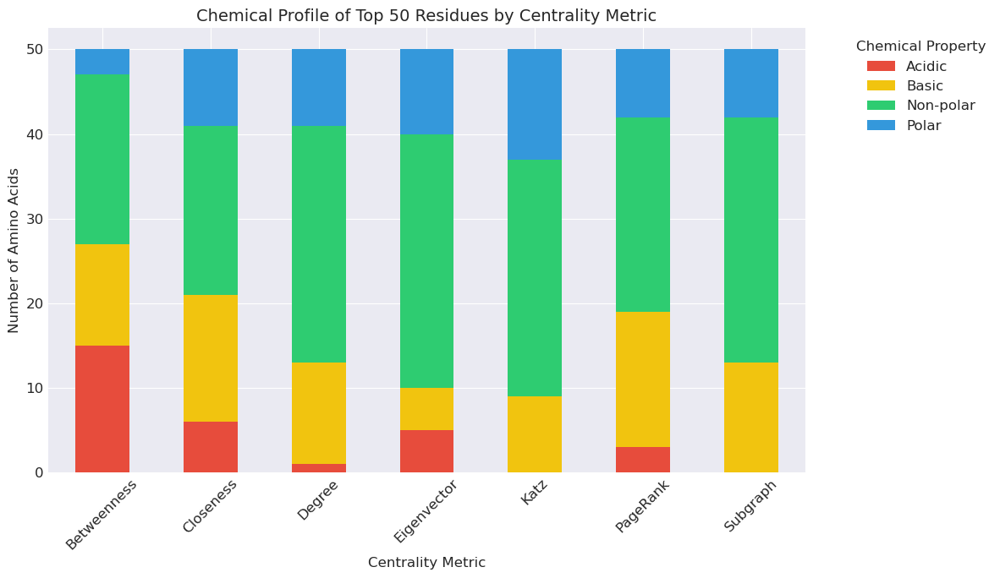

In [ ]:
df_chemical_count_G_S01 = plot_physicochemical_centrality_comparison(df_top50_G_S01)

/tmp/ipykernel_3242835/1180007292.py:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




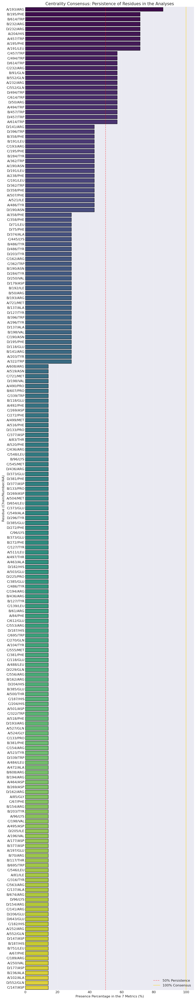

In [ ]:
df_key_residues_G_S01 = generate_complete_persistence_analysis(df_top50_G_S01)

In [ ]:
#visualize_persistence_3d(df_key_residues_G_S01, pdb_path='./6EDW-R.pdb')
visualize_persistence_3d_clean(df_key_residues_G_S01, pdb_path='../structures/6EDW-R.pdb')

✅ Visualizing ./6EDW-R.pdb. Labels only shown for the 10 most persistent residues.


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
visualize_3d_persistence_pro(df_key_residues_G_S01, pdb_path='../structures/6EDW-R.pdb', show_labels=False)

🔹 Showing ./6EDW-R.pdb without labels (clean view)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
nearby_residues_MG804 = find_nearby_amino_acids('../structures/6EDW-R.pdb', target_residue="MG", residue_number=804, distance=4.0)
df_nearby_MG804 = pd.DataFrame(nearby_residues)
df_nearby_MG804

,chain,residue,number,distance
0,A,GLY,107,3.813330
1,A,ASP,123,3.562653
2,A,ASP,177,2.661656
3,A,ASP,179,2.212882
4,A,LYS,213,3.402298


#### d) Null models

Null models: generate ten Erdős–Rényi (ER) and ten Barabási–Albert (BA) networks with the same number of nodes and edges as your real network.

In [ ]:
df_nulls_G_S01 = null_models_analysis(G_S01)
df_nulls_G_S01

,Metric,Real,ER_Mean,ER_Std,BA_Mean,BA_Std
Alpha,Alpha,2.612329,2.531572,1.342836e-02,2.642314,1.133533e-01
Avg_Betweenness,Avg_Betweenness,0.005628,0.001973,3.133456e-05,0.002439,1.116335e-04
Avg_Closeness,Avg_Closeness,0.043055,0.102279,8.009819e-04,0.126513,5.394123e-03
Avg_Eigenvector,Avg_Eigenvector,0.003291,0.011125,5.280911e-04,0.004022,2.674798e-04
Avg_PageRank,Avg_PageRank,0.000338,0.000338,7.666467e-20,0.000338,4.780882e-20


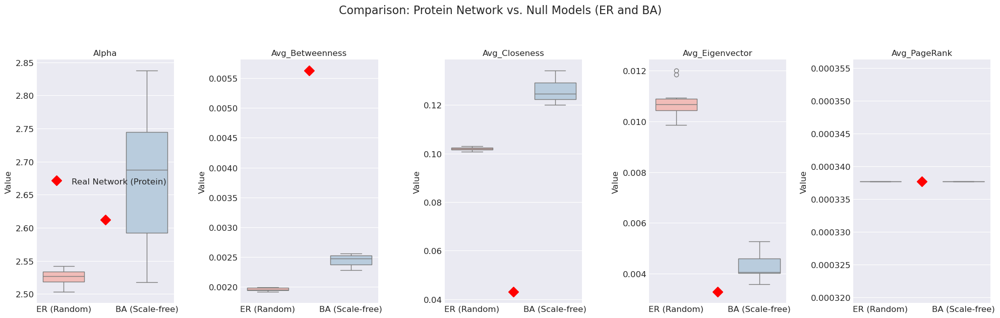

In [ ]:
plot_null_model_comparison(G_S01)

#### f) Community analysis

**Infomap Community analysis**

/tmp/ipykernel_3242835/2626780255.py:20: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



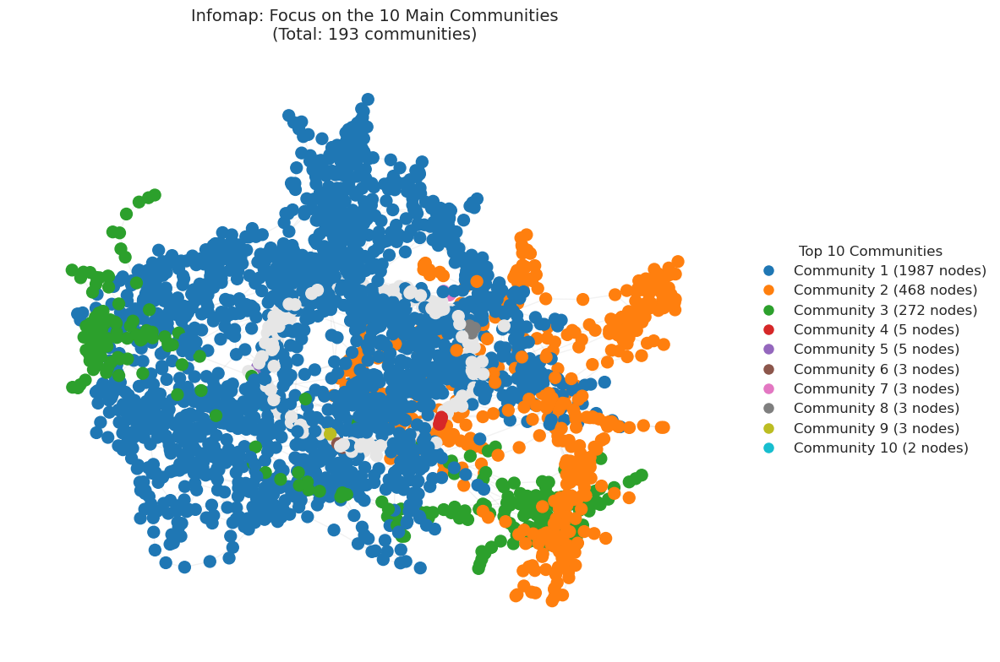

In [ ]:
result_S01 = analyze_and_visualize_infomap(G_S01)

**Comparative Community analysis**

/tmp/ipykernel_3242835/514235415.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



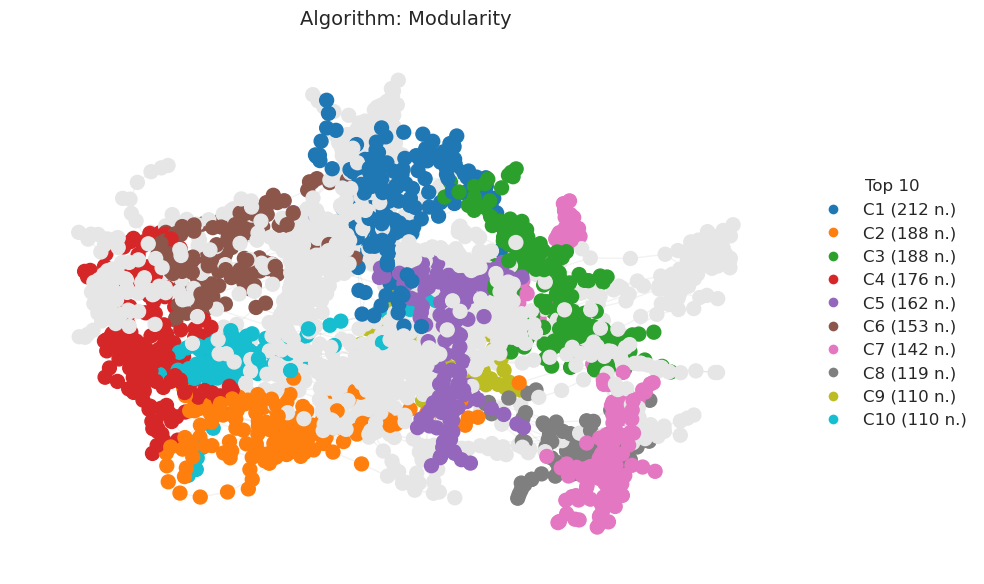

/tmp/ipykernel_3242835/514235415.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



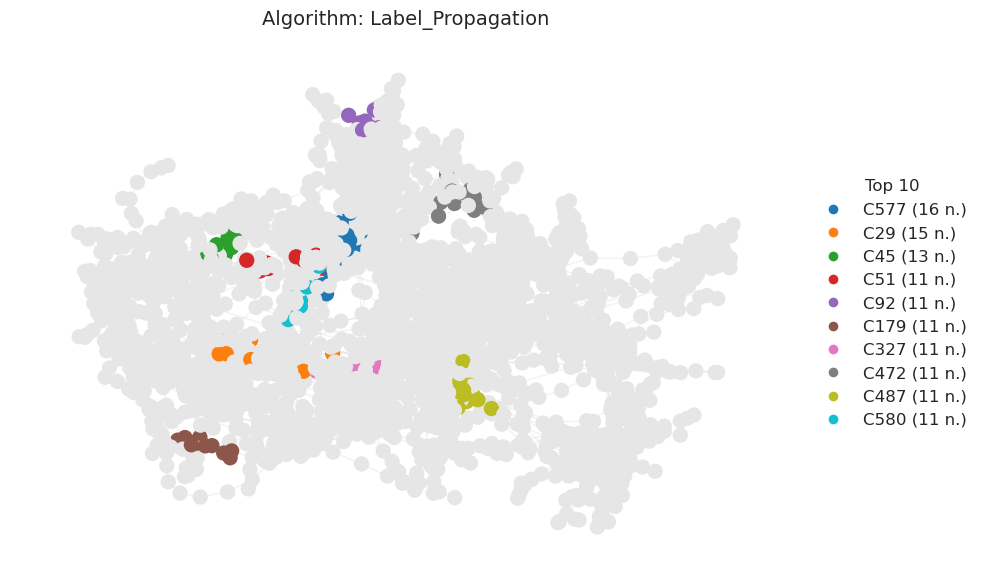

/tmp/ipykernel_3242835/514235415.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



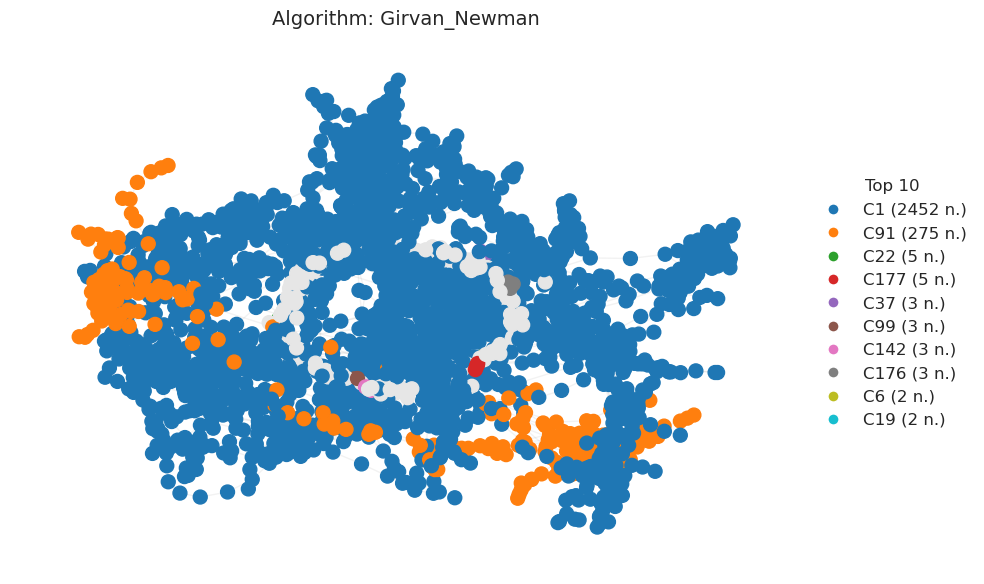

/tmp/ipykernel_3242835/514235415.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



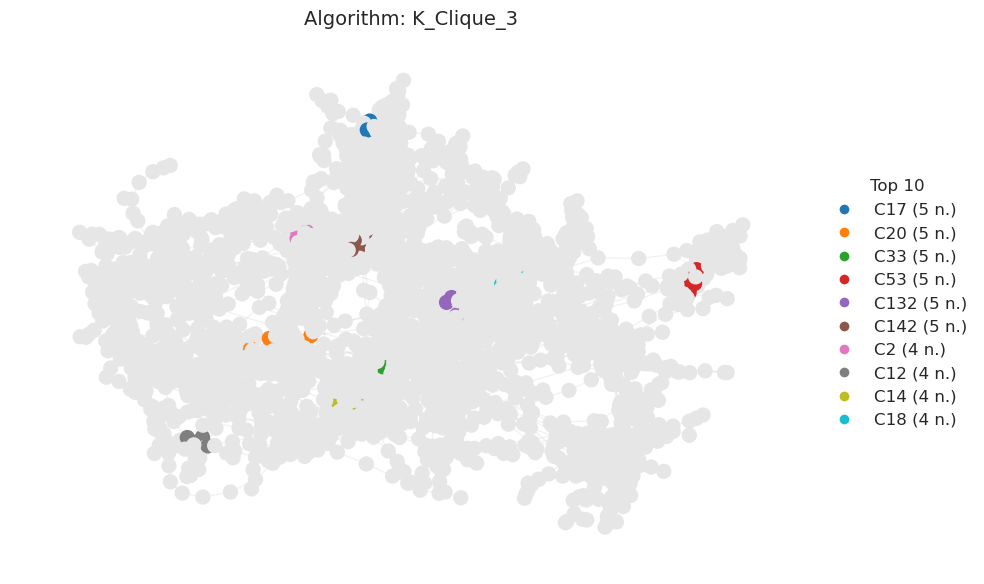

✅ Analysis complete. File saved as: G_S01_mi_analisis_completo.csv


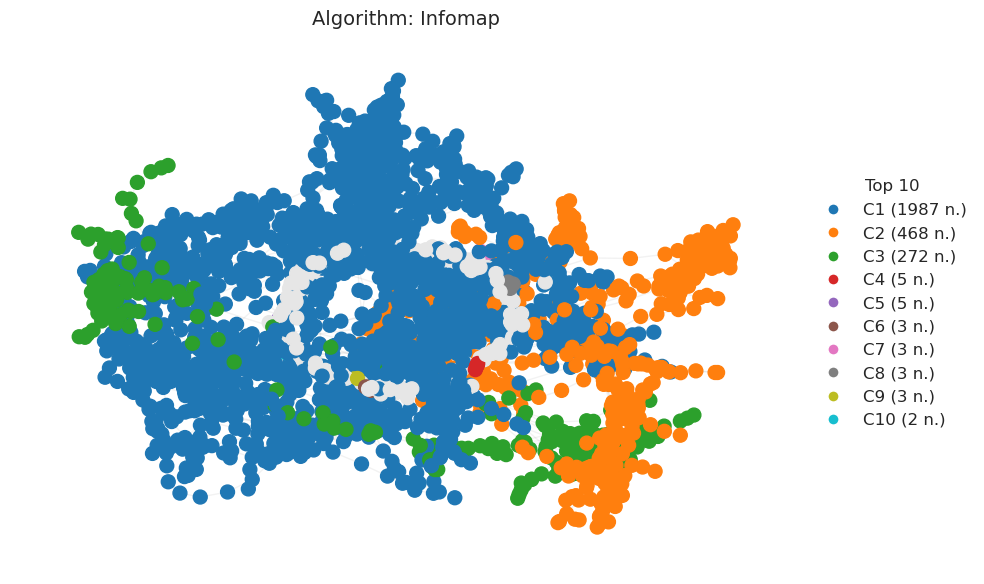

In [ ]:
df_resultados_Community_analysis_G_S01 = comparative_community_analysis(G_S01, "G_S01_mi_analisis_completo.csv")

In [ ]:
# Reading the generated Community Data
nombre_archivo_G_S01 = "G_S01_mi_analisis_completo.csv"
df_community_analisis_G_S01 = pd.read_csv(nombre_archivo_G_S01)
df_community_analisis_G_S01

,Node,Infomap,Modularity,Label_Propagation,Girvan_Newman,K_Clique_3
0,A/100/ILE,1,4,1,1,0
1,A/101/GLU,1,6,2,1,0
2,A/102/ALA,1,4,3,1,0
3,A/103/ILE,1,6,4,1,0
4,A/104/TYR,1,4,5,1,0
...,...,...,...,...,...,...
2956,D/95/MET,1,3,461,1,0
2957,D/96/LYS,1,3,787,1,0
2958,D/97/ARG,1,1,788,1,0
2959,D/98/MET,1,3,461,1,0


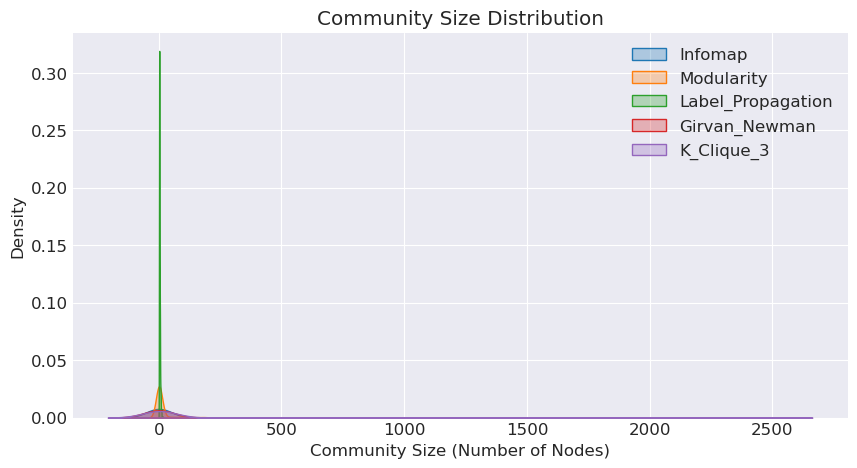

In [ ]:
# Count community sizes by method and graph them
plt.figure(figsize=(10, 5))
for metodo in metodos:
    counts_G_S01 = df_community_analisis_G_S01[metodo].value_counts().values
    sns.kdeplot(counts_G_S01, label=metodo, fill=True, alpha=0.3)

plt.xlabel("Community Size (Number of Nodes)")
plt.ylabel("Density")
plt.title("Community Size Distribution")
plt.legend()
plt.show()

**Consensus analysis between community analysis algorithms**

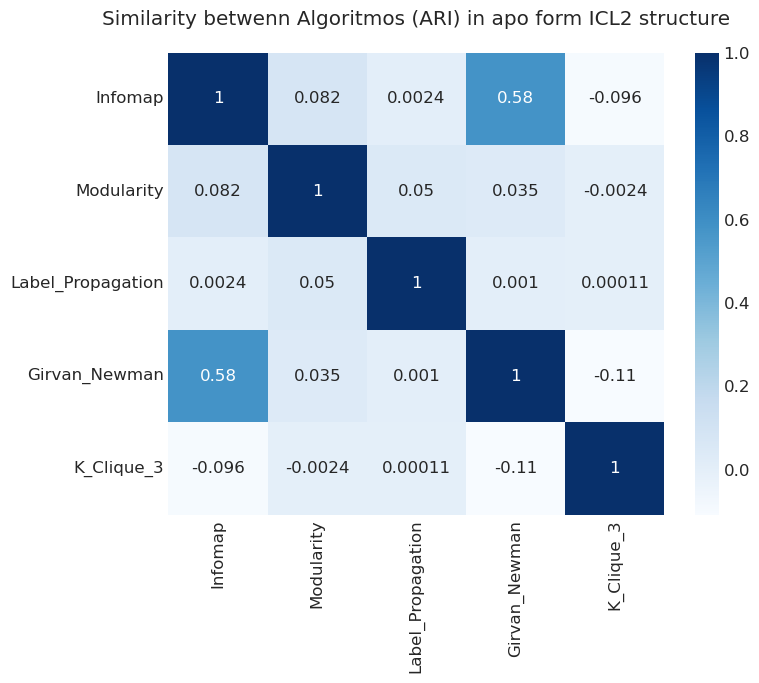

In [ ]:
from sklearn.metrics import adjusted_rand_score
import seaborn as sns

# Calculate similarity matrix between columns
metodos = df_community_analisis_G_S01.columns[1:] # Excluimos la columna 'Nodo'
ari_matrix_G_S01 = pd.DataFrame(index=metodos, columns=metodos)

for m1 in metodos:
    for m2 in metodos:
        ari_matrix_G_S01.loc[m1, m2] = adjusted_rand_score(df_community_analisis_G_S01[m1], df_community_analisis_G_S01[m2])

plt.figure(figsize=(8, 6))
sns.heatmap(ari_matrix_G_S01.astype(float), annot=True, cmap='Blues')
plt.title("Similarity betwenn Algoritmos (ARI) in apo form ICL2 structure",
          pad=20)
plt.show()

In [ ]:
visualize_local_pdb_communities(df_community_analisis_G_S01, 'Infomap', '../structures/6EDW-R.pdb', n_communities=4)

📊 Coloring the 4 largest communities for method: Infomap
   - Community 1: #1f77b4 (1987 residues)
   - Community 2: #ff7f0e (468 residues)
   - Community 3: #2ca02c (272 residues)
   - Community 4: #d62728 (5 residues)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
visualize_local_pdb_communities(df_community_analisis_G_S01, 'Girvan_Newman', '../structures/6EDW-R.pdb', n_communities=4)

📊 Coloring the 4 largest communities for method: Girvan_Newman
   - Community 1: #1f77b4 (2452 residues)
   - Community 91: #ff7f0e (275 residues)
   - Community 177: #2ca02c (5 residues)
   - Community 22: #d62728 (5 residues)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

**Which nodes are most related?**

In [ ]:
nodos = df_community_analisis_G_S01['Node'].values
n = len(nodos)
co_occurrence = np.zeros((n, n))

# Iterate through each pair of nodes
for i in range(n):
    for j in range(i + 1, n):
        # Count how many columns have the same values ​​in row i and j
        matches = (df_community_analisis_G_S01.iloc[i, 1:] == df_community_analisis_G_S01.iloc[j, 1:]).sum()
        co_occurrence[i, j] = co_occurrence[j, i] = matches

# Visualize a sample or the nodes with the highest relationship
plt.figure(figsize=(10, 8))
sns.heatmap(co_occurrence[:30, :30], xticklabels=nodos[:30], yticklabels=nodos[:30], cmap="YlGnBu")
plt.title("Consensus Matrix (First 30 nodes)")
plt.show()

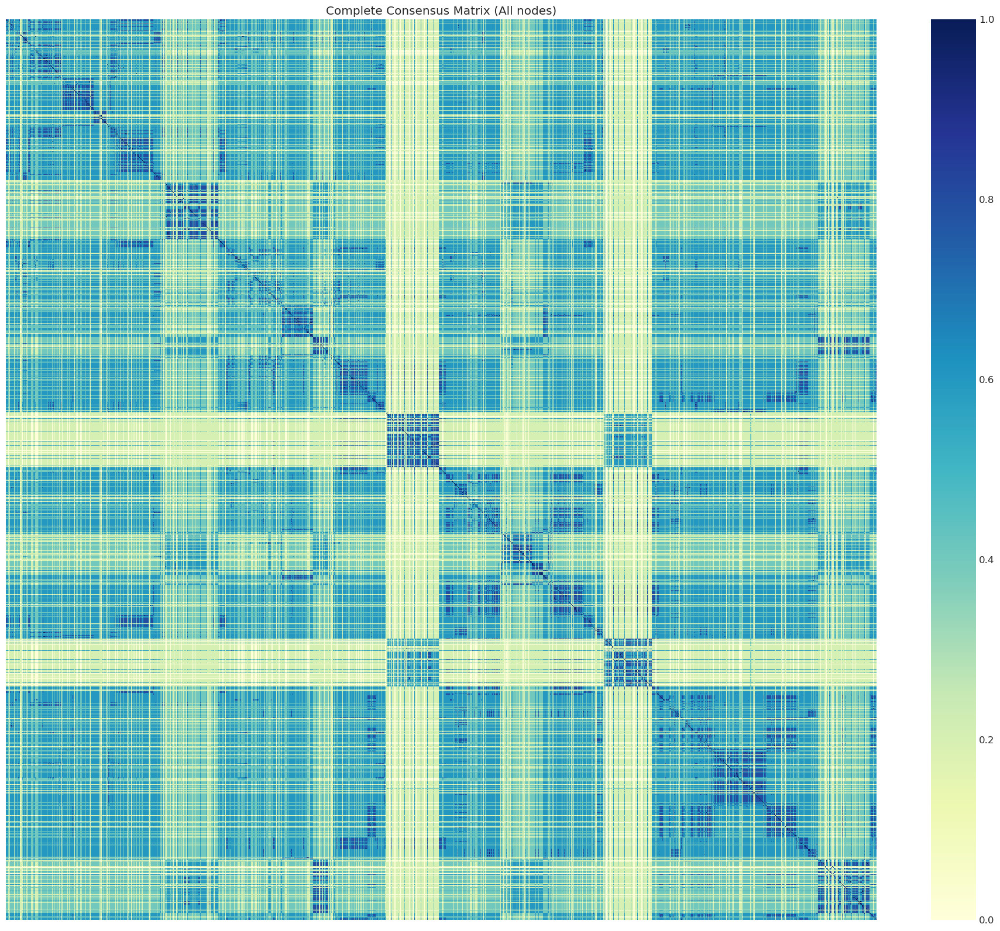

In [ ]:
# Consensus Matrix
matriz_total_G_S01 = generate_consensus_matrix(df_community_analisis_G_S01)

# Visualización (si n_nodos es manejable, ej. < 200)
plt.figure(figsize=(24, 20))
sns.heatmap(matriz_total_G_S01, cmap="YlGnBu", xticklabels=False, yticklabels=False)
plt.title("Complete Consensus Matrix (All nodes)")
plt.savefig("G_S01_Consensus Matrix.png", dpi=300, bbox_inches='tight')
plt.savefig("G_S01_Consensus Matrix.pdf", bbox_inches='tight')
plt.savefig("G_S01_Consensus Matrix.svg", bbox_inches='tight')
plt.show()

**Generate Consensus graph**

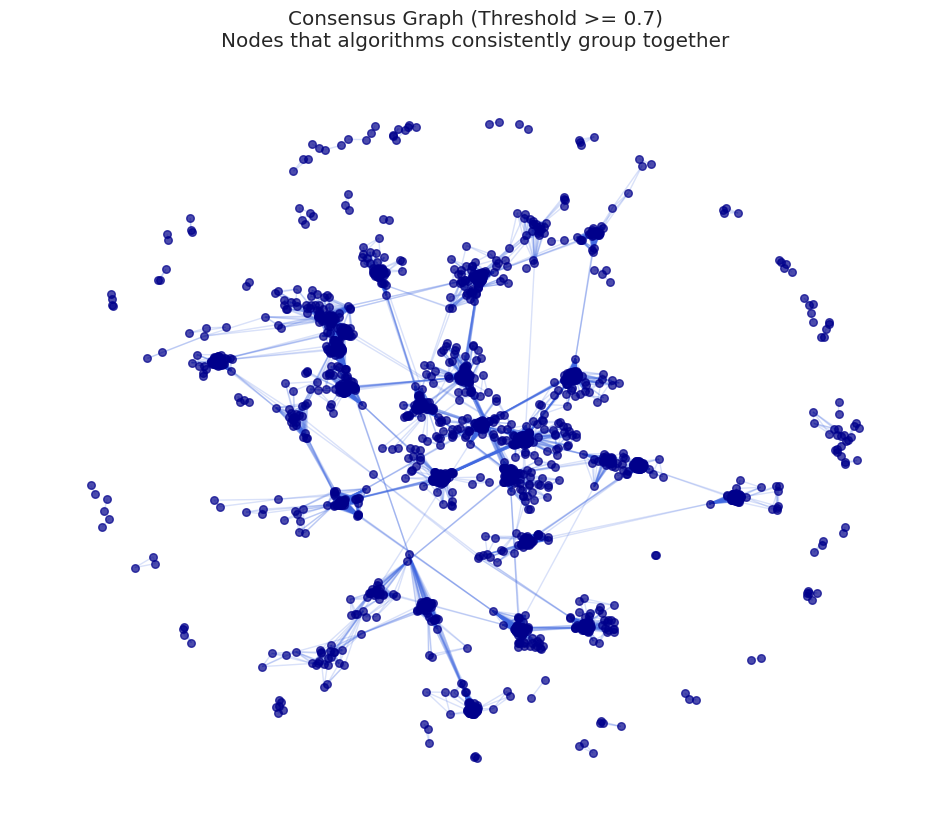

Identified 114853 reliable relationships.


In [ ]:
df_gold_relationships_G_S01, network_gold_relationships_G_S01 = extract_consensus_and_plot(df_community_analisis_G_S01, threshold=0.7)

**Umbral analysis in concensus graph**

In [ ]:
df_gold_relationships_G_S01

,Node_A,Node_B,Consensus_Strength
0,A/100/ILE,A/102/ALA,0.8
1,A/100/ILE,A/104/TYR,0.8
2,A/100/ILE,A/109/ALA,0.8
3,A/100/ILE,A/112/ALA,0.8
4,A/100/ILE,A/113/LYS,0.8
...,...,...,...
114848,D/95/MET,D/98/MET,1.0
114849,D/95/MET,D/99/GLY,0.8
114850,D/96/LYS,D/98/MET,0.8
114851,D/96/LYS,D/99/GLY,1.0


Multi-threshold consensus file generated: multi_threshold_consensus.csv


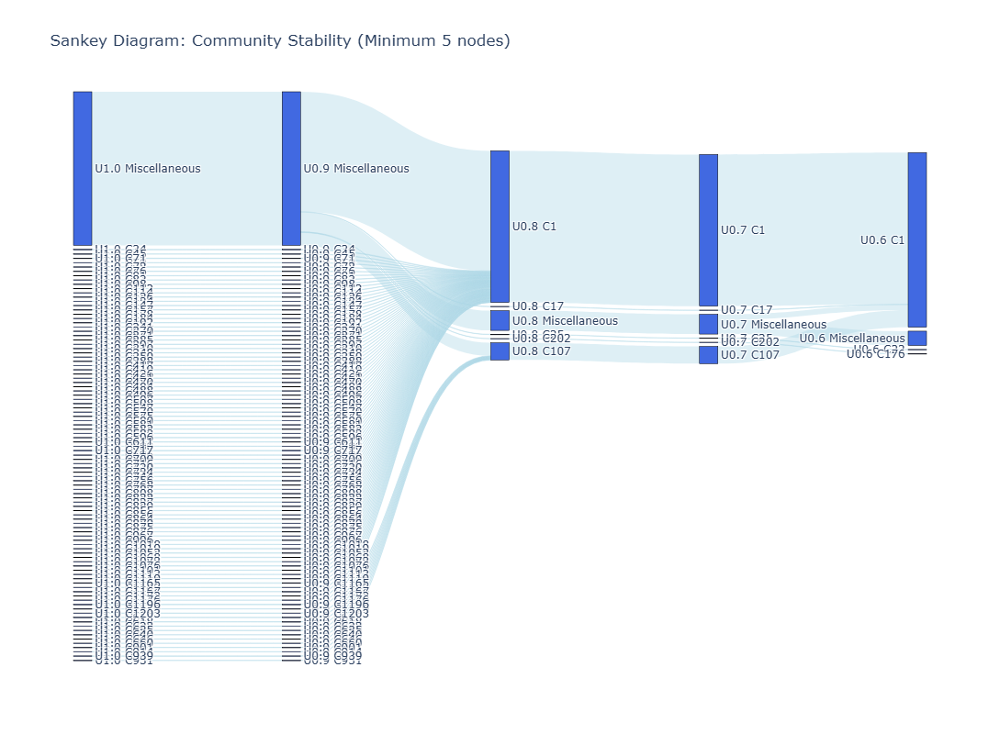

In [ ]:
df_multi_threshold_G_S01 = generate_multi_threshold_consensus_csv(df_community_analisis_G_S01, thresholds=[1.0, 0.9, 0.8, 0.7, 0.6])

In [ ]:
df_multi_threshold_G_S01

,Node,threshold_1.0,threshold_0.9,threshold_0.8,threshold_0.7,threshold_0.6
0,A/100/ILE,1,1,1,1,1
1,A/101/GLU,2,2,1,1,1
2,A/102/ALA,3,3,1,1,1
3,A/103/ILE,4,4,1,1,1
4,A/104/TYR,5,5,1,1,1
...,...,...,...,...,...,...
2956,D/95/MET,581,581,1,1,1
2957,D/96/LYS,996,996,1,1,1
2958,D/97/ARG,997,997,1,1,1
2959,D/98/MET,581,581,1,1,1


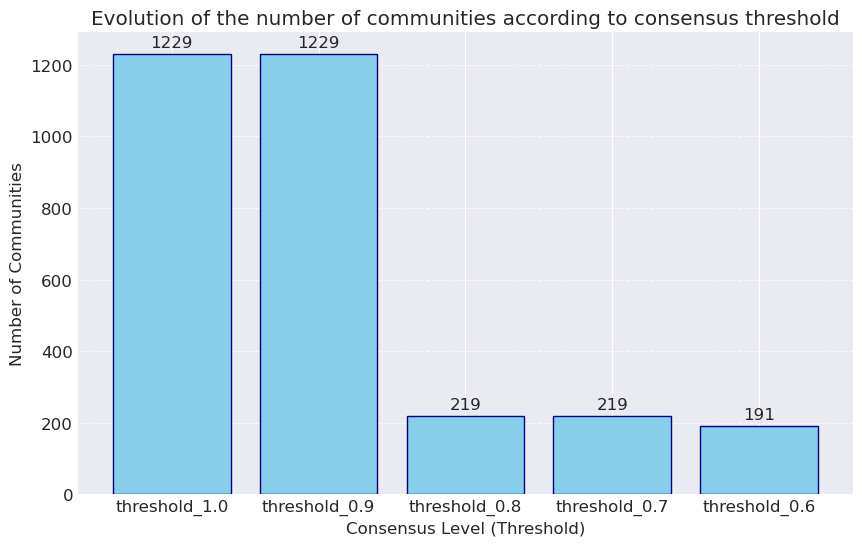

In [ ]:
plot_unit_count(df_multi_threshold_G_S01)

In [ ]:
#Execute Sankey passing that specific dataframe
generate_filtered_sankey(df_multi_threshold_G_S01, min_nodes=5)

In [ ]:
# (Opcional) Establecer el nodo como el índice para realizar búsquedas rápidas
# df_analisis.set_index('Nodo', inplace=True)

# 3. Mostrar las primeras filas y un resumen rápido
print("Vista previa del análisis comparativo:")
print(df_community_analisis_G_S01.head())

print("\nConteo de comunidades por cada método:")
print(df_community_analisis_G_S01.nunique())

 #### e) Structural analysis


=== ANÁLISIS DE TIPOS DE INTERACCIÓN ===
Tipos de interacción encontrados (columna: interaction):
interaction
VDW          264
HBOND         34
PIPISTACK     14
SSBOND         2
IONIC          2
PICATION       1
Name: count, dtype: int64


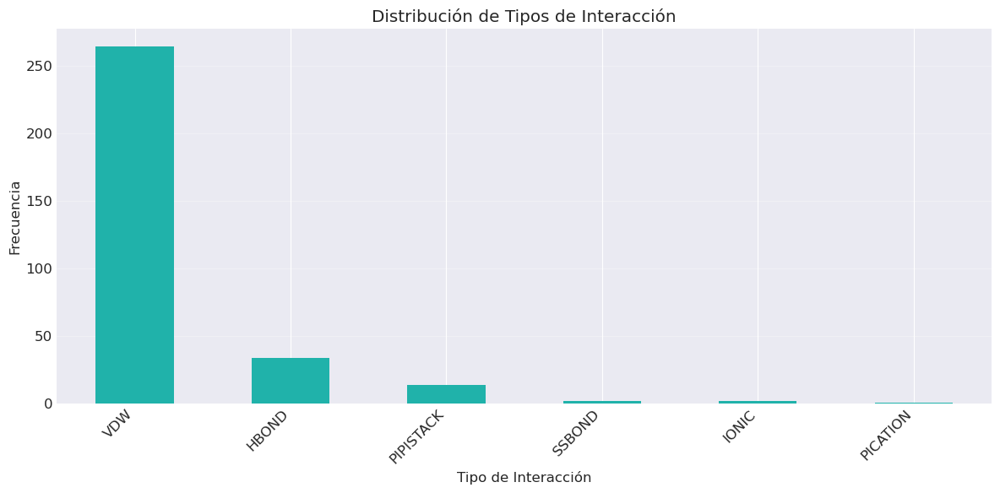

In [ ]:
# Analizar tipos de interacción
distribucion_interacciones_S01 = analizar_tipos_interaccion(df_aristas_S01, G_S01)

In [ ]:
df_Structural_properties_G_S01 = analyze_allosteric_properties('../structures/6EDW-R.pdb')

In [ ]:
df_Structural_properties_G_S01


,id,SASA,B-Factor,Hydrophobicity,Packing_Density
0,A/12/THR,66.29,63.66,-0.7,5
1,A/13/PRO,89.36,52.03,-1.6,6
2,A/14/PHE,46.37,32.88,2.8,6
3,A/15/GLU,75.99,53.76,-3.5,7
4,A/16/GLN,122.89,49.32,-3.5,8
...,...,...,...,...,...
2950,D/760/LYS,145.84,47.56,-3.9,9
2951,D/761/LEU,7.25,28.68,3.8,9
2952,D/762/ILE,3.62,32.31,4.5,7
2953,D/763/THR,38.59,42.88,-0.7,7


📊 Spearman Correlation: -0.353 (p-value: 1.949e-87)

🚀 Candidates for Rigid Allosteric Centers (High Betweenness / Low B-Factor):
           Node  Betweenness_Val  B-Factor
2526  D/385/GLU         0.152552     24.23
2402  D/272/PHE         0.147662     17.68
2513  D/373/GLU         0.147328     22.49
2582  D/436/ARG         0.147061     24.37
2522  D/381/PHE         0.142937     21.57


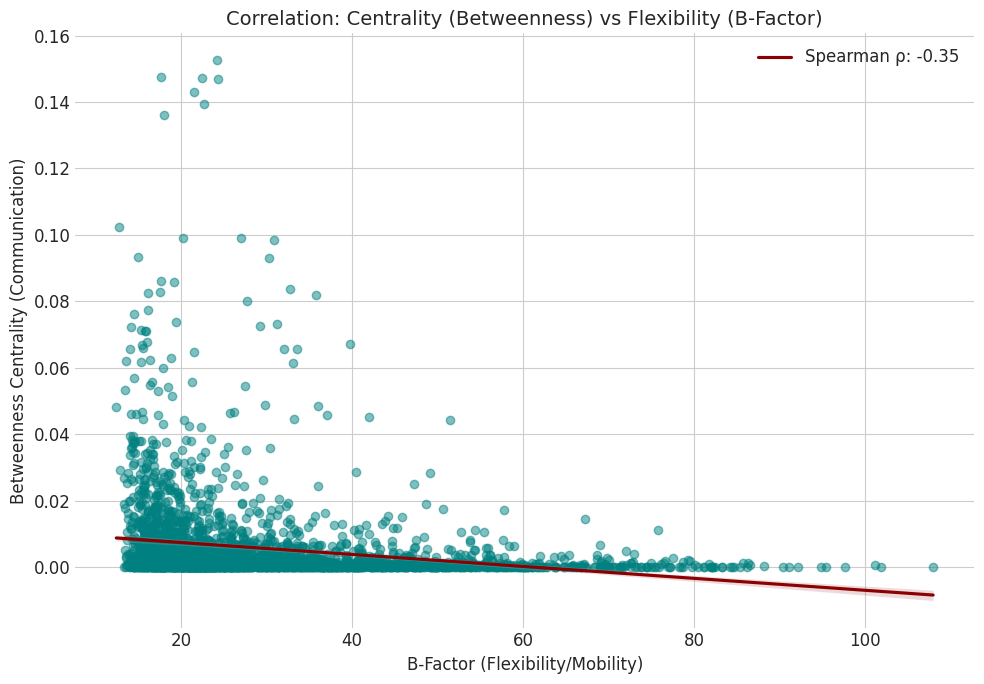

In [ ]:
df_Betweeness_B_factor_G_S01 = plot_network_structure_correlation(df_full_G_S01F, df_Structural_properties_G_S01)

#### Percolation Analysis

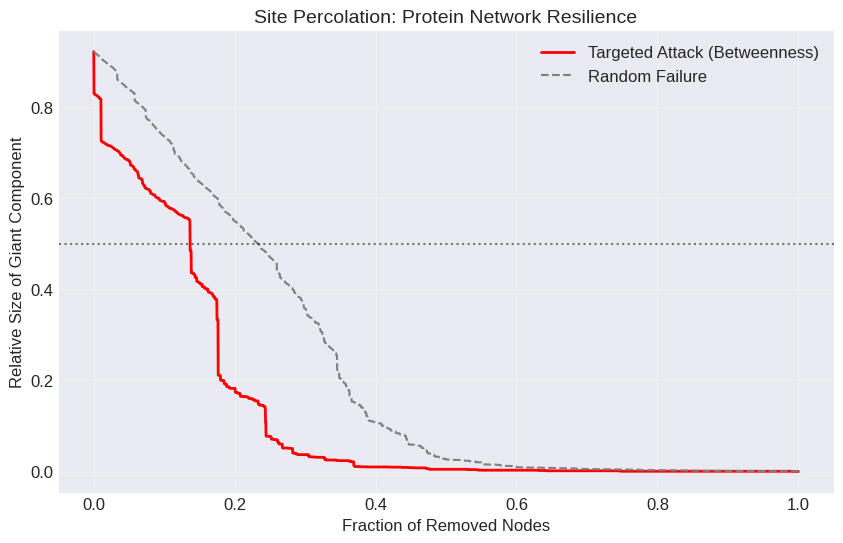

In [ ]:
df_percolacion_G_S01 = site_percolation_analysis(G_S01)

In [ ]:
df_percolacion_G_S01

,Fracción,Targeted_Size,Random_Size
0,0.000000,0.920973,0.920973
1,0.000338,0.828774,0.920567
2,0.000675,0.828436,0.920162
3,0.001013,0.827761,0.919824
4,0.001351,0.827761,0.919284
...,...,...,...
2957,0.998649,0.000338,0.000338
2958,0.998987,0.000338,0.000338
2959,0.999325,0.000338,0.000338
2960,0.999662,0.000338,0.000338
